In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)


# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:

        print(os.path.join(dirname, filename))


# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

<H2> In his project, we are analysing bank churning data. 
    In input we have 13 features and output is 'Exited' feature.

<H2>Imporing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import category_encoders as ce
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
from catboost import CatBoostClassifier

<h2> Load data

In [2]:
train_data=pd.read_csv(r"kaggle/input/playground-series-s4e1/train.csv")
test_data=pd.read_csv(r"kaggle/input/playground-series-s4e1/test.csv")
sample_sub=pd.read_csv(r"kaggle/input/playground-series-s4e1/sample_submission.csv")
test_data.describe()

,id,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary
count,110023.000000,1.100230e+05,110023.000000,110023.000000,110023.000000,110023.000000,110023.000000,110023.000000,110023.000000,110023.000000
mean,220045.000000,1.569210e+07,656.530789,38.122205,4.996637,55333.611354,1.553321,0.753043,0.495233,112315.147765
std,31761.048671,7.168499e+04,80.315415,8.861550,2.806148,62788.519675,0.544714,0.431244,0.499980,50277.048244
min,165034.000000,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.000000,0.000000,11.580000
25%,192539.500000,1.563286e+07,597.000000,32.000000,3.000000,0.000000,1.000000,1.000000,0.000000,74440.325000
50%,220045.000000,1.569018e+07,660.000000,37.000000,5.000000,0.000000,2.000000,1.000000,0.000000,117832.230000
75%,247550.500000,1.575693e+07,710.000000,42.000000,7.000000,120145.605000,2.000000,1.000000,1.000000,154631.350000
max,275056.000000,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.000000,1.000000,199992.480000


In [3]:
print("Formato do train data ", train_data.shape)
print("MOstrando as colunas dos dados", train_data.columns.values)

Formato do train data  (165034, 14)
MOstrando as colunas dos dados ['id' 'CustomerId' 'Surname' 'CreditScore' 'Geography' 'Gender' 'Age'
 'Tenure' 'Balance' 'NumOfProducts' 'HasCrCard' 'IsActiveMember'
 'EstimatedSalary' 'Exited']


In [4]:
train_data.head()

,id,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,0,15674932,Okwudilichukwu,668,France,Male,33.0,3,0.00,2,1.0,0.0,181449.97,0
1,1,15749177,Okwudiliolisa,627,France,Male,33.0,1,0.00,2,1.0,1.0,49503.50,0
2,2,15694510,Hsueh,678,France,Male,40.0,10,0.00,2,1.0,0.0,184866.69,0
3,3,15741417,Kao,581,France,Male,34.0,2,148882.54,1,1.0,1.0,84560.88,0
4,4,15766172,Chiemenam,716,Spain,Male,33.0,5,0.00,2,1.0,1.0,15068.83,0


In [5]:
test_data.head()

,id,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary
0,165034,15773898,Lucchese,586,France,Female,23.0,2,0.00,2,0.0,1.0,160976.75
1,165035,15782418,Nott,683,France,Female,46.0,2,0.00,1,1.0,0.0,72549.27
2,165036,15807120,K?,656,France,Female,34.0,7,0.00,2,1.0,0.0,138882.09
3,165037,15808905,O'Donnell,681,France,Male,36.0,8,0.00,1,1.0,0.0,113931.57
4,165038,15607314,Higgins,752,Germany,Male,38.0,10,121263.62,1,1.0,0.0,139431.00


In [6]:
sample_sub.head()

,id,Exited
0,165034,0.5
1,165035,0.5
2,165036,0.5
3,165037,0.5
4,165038,0.5


In [7]:
train_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165034 entries, 0 to 165033
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               165034 non-null  int64  
 1   CustomerId       165034 non-null  int64  
 2   Surname          165034 non-null  object 
 3   CreditScore      165034 non-null  int64  
 4   Geography        165034 non-null  object 
 5   Gender           165034 non-null  object 
 6   Age              165034 non-null  float64
 7   Tenure           165034 non-null  int64  
 8   Balance          165034 non-null  float64
 9   NumOfProducts    165034 non-null  int64  
 10  HasCrCard        165034 non-null  float64
 11  IsActiveMember   165034 non-null  float64
 12  EstimatedSalary  165034 non-null  float64
 13  Exited           165034 non-null  int64  
dtypes: float64(5), int64(6), object(3)
memory usage: 17.6+ MB


In [8]:
train_data['Age'] = train_data['Age'].astype(int)
train_data['HasCrCard'] = train_data['HasCrCard'].astype(int)
train_data['IsActiveMember'] = train_data['IsActiveMember'].astype(int)
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165034 entries, 0 to 165033
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               165034 non-null  int64  
 1   CustomerId       165034 non-null  int64  
 2   Surname          165034 non-null  object 
 3   CreditScore      165034 non-null  int64  
 4   Geography        165034 non-null  object 
 5   Gender           165034 non-null  object 
 6   Age              165034 non-null  int64  
 7   Tenure           165034 non-null  int64  
 8   Balance          165034 non-null  float64
 9   NumOfProducts    165034 non-null  int64  
 10  HasCrCard        165034 non-null  int64  
 11  IsActiveMember   165034 non-null  int64  
 12  EstimatedSalary  165034 non-null  float64
 13  Exited           165034 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 17.6+ MB


In [9]:
train_data.describe()

,id,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,165034.0000,1.650340e+05,165034.000000,165034.000000,165034.000000,165034.000000,165034.000000,165034.000000,165034.000000,165034.000000,165034.000000
mean,82516.5000,1.569201e+07,656.454373,38.125883,5.020353,55478.086689,1.554455,0.753954,0.497770,112574.822734,0.211599
std,47641.3565,7.139782e+04,80.103340,8.867207,2.806159,62817.663278,0.547154,0.430707,0.499997,50292.865585,0.408443
min,0.0000,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.000000,0.000000,11.580000,0.000000
25%,41258.2500,1.563314e+07,597.000000,32.000000,3.000000,0.000000,1.000000,1.000000,0.000000,74637.570000,0.000000
50%,82516.5000,1.569017e+07,659.000000,37.000000,5.000000,0.000000,2.000000,1.000000,0.000000,117948.000000,0.000000
75%,123774.7500,1.575682e+07,710.000000,42.000000,7.000000,119939.517500,2.000000,1.000000,1.000000,155152.467500,0.000000
max,165033.0000,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.000000,1.000000,199992.480000,1.000000


In [10]:
train_data['NumOfProducts'].unique()

array([2, 1, 3, 4])

In [11]:
train_data['Geography'].unique()

array(['France', 'Spain', 'Germany'], dtype=object)

In [12]:
train_data['Gender'].unique()

array(['Male', 'Female'], dtype=object)

In [13]:
train_data['Tenure'].unique()

array([ 3,  1, 10,  2,  5,  4,  8,  6,  9,  7,  0])

<h2> Features Division </h2>
    
Categorical features- Gender(Text), Geography(Text), Tenure, NumOfProducts \
Numerical features- id, CustomerId, CreditScore, Age,  Balance, EstimatedSalary\
Binary features- IsActiveMember, HasCrCard, Exited \
Text- Surname

In [14]:
fig = px.histogram(train_data, x='Exited',text_auto=True, title='Churn Distribution')

fig.show()

130.113 clientes permaneceram (79,0%) enquanto 34.921 clientes evadiram de um total de 165034 clientes

In [15]:
fig = px.histogram(train_data, x='Geography',color="Exited",barmode='group',text_auto=True,title="Gráfico de barras agrupadas de rotatividade por região geográfica")
fig.show()

In [16]:
fig = px.histogram(train_data, x='Gender',color="Exited",barmode='group',title="Gráfico de barras agrupadas de rotatividade por genero")
fig.show()

In [17]:
fig = px.histogram(train_data, x='Geography',color="Exited",barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for Geography")
fig.show()

Germany has highest churn rate

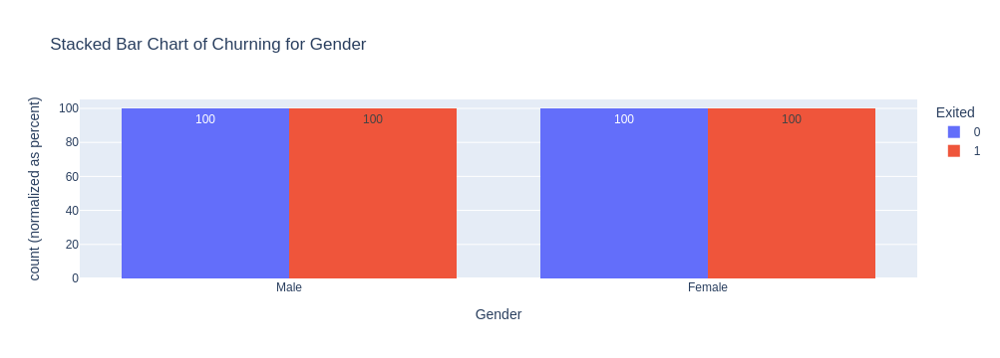

In [23]:
fig = px.histogram(train_data, x='Gender',color="Exited",barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for Gender")
fig.show()

Female has more churn rate

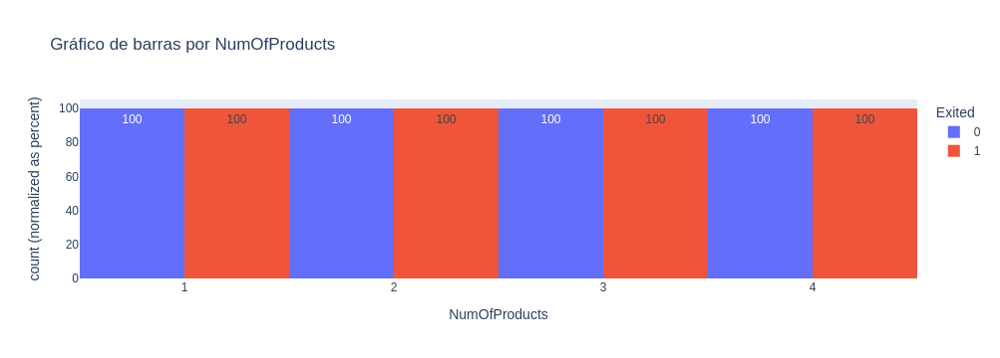

In [24]:
fig = px.histogram(train_data, x='NumOfProducts',color="Exited",barnorm="percent",text_auto=True,title="Gráfico de barras por NumOfProducts")
fig.show()

Product 2 has minimum churn rate and 3 and 4 has highest churn rate

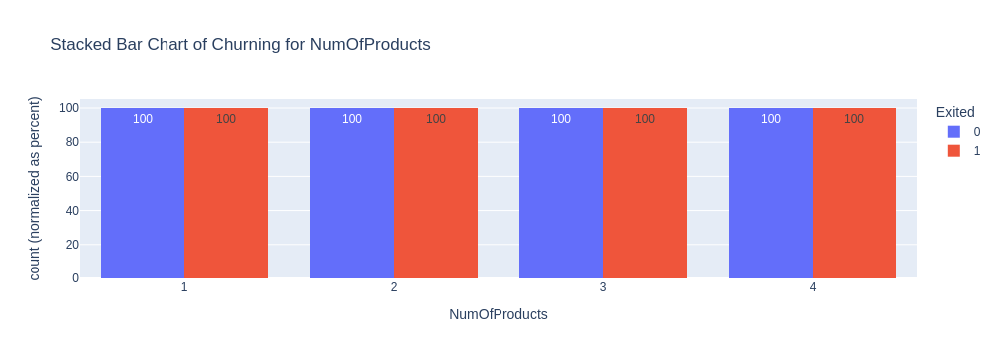

In [25]:
fig = px.histogram(train_data, x='NumOfProducts',color="Exited",barmode='group', barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for NumOfProducts")
fig.show()

In [18]:
fig = px.histogram(train_data, x='HasCrCard',color="Exited",barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for HasCrCard")
fig.show()

In [19]:
fig = px.histogram(train_data, x='HasCrCard',color="Exited",barmode='group', barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for HasCrCard")
fig.show()

In [20]:
fig = px.histogram(train_data, x='IsActiveMember',color="Exited",barnorm="percent",text_auto=True,title="Gráfico em barra agrupada para IsActiveMember")
fig.show()

In [21]:
fig = px.histogram(train_data, x='Tenure',color="Exited",text_auto=True,title="Gráfico em barra agrupada para Tenure")
fig.show()

Os Tenure 0 e 10 têm um número mínimo de clientes, portanto, também apresentam uma taxa mínima de churn.

In [22]:
fig = px.histogram(train_data, x='Tenure',color="Exited",barmode='group', barnorm="percent",text_auto=True,title="Stacked Bar Chart of Churning for Tenure")
fig.show()

0 Tenure tem a maior taixa de churn

<h3>Features does not matter according to analysis </h3>
'id', 'CustomerId' ,'Surname' ,'HasCrCard'

In [23]:

print("Print columns data ", train_data.columns.values)

Print columns data  ['id' 'CustomerId' 'Surname' 'CreditScore' 'Geography' 'Gender' 'Age'
 'Tenure' 'Balance' 'NumOfProducts' 'HasCrCard' 'IsActiveMember'
 'EstimatedSalary' 'Exited']


In [24]:
df=train_data.drop(['id', 'CustomerId'  ,'HasCrCard', 'Surname'], axis=1)


In [25]:
df_test=test_data.drop(['id', 'CustomerId'  ,'HasCrCard', 'Surname'], axis=1)

In [26]:
df.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,IsActiveMember,EstimatedSalary,Exited
0,668,France,Male,33,3,0.00,2,0,181449.97,0
1,627,France,Male,33,1,0.00,2,1,49503.50,0
2,678,France,Male,40,10,0.00,2,0,184866.69,0
3,581,France,Male,34,2,148882.54,1,1,84560.88,0
4,716,Spain,Male,33,5,0.00,2,1,15068.83,0


In [27]:
print("Print new train data shape ",df.shape)
print("Print new train data info ",df.info())

Print new train data shape  (165034, 10)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165034 entries, 0 to 165033
Data columns (total 10 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   CreditScore      165034 non-null  int64  
 1   Geography        165034 non-null  object 
 2   Gender           165034 non-null  object 
 3   Age              165034 non-null  int64  
 4   Tenure           165034 non-null  int64  
 5   Balance          165034 non-null  float64
 6   NumOfProducts    165034 non-null  int64  
 7   IsActiveMember   165034 non-null  int64  
 8   EstimatedSalary  165034 non-null  float64
 9   Exited           165034 non-null  int64  
dtypes: float64(2), int64(6), object(2)
memory usage: 12.6+ MB
Print new train data info  None


In [28]:
Churn_back = df[df['Exited']==1]['CreditScore'].values
Churn_not = df[df['Exited']==0]['CreditScore'].values

{'whiskers': [<matplotlib.lines.Line2D at 0x7b12097af1a0>,
 'caps': [<matplotlib.lines.Line2D at 0x7b12097af740>,
 'boxes': [<matplotlib.lines.Line2D at 0x7b12097adc40>,
 'medians': [<matplotlib.lines.Line2D at 0x7b12097afd70>,
 'fliers': [<matplotlib.lines.Line2D at 0x7b1209838d40>,
 'means': []}

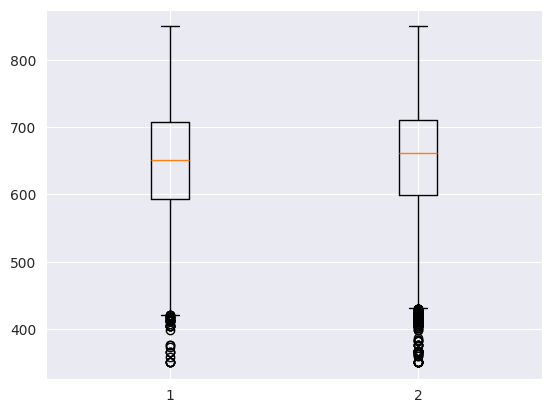

In [29]:
plt.boxplot([Churn_back, Churn_not])

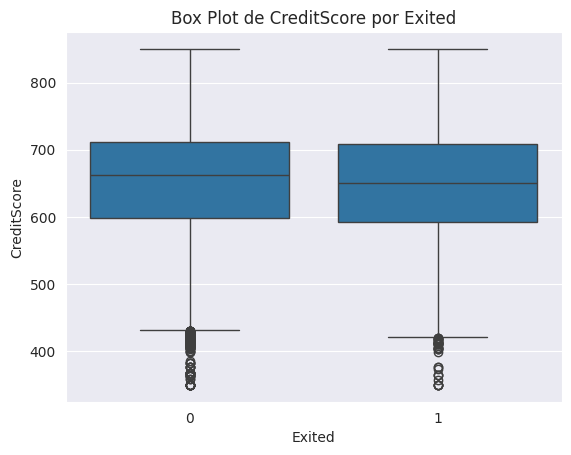

In [30]:

sns.boxplot(x='Exited', y='CreditScore', data=df)
plt.title('Box Plot de CreditScore por Exited')
plt.show()

In [31]:


fig = px.box(df, x="Exited", y="CreditScore")
fig.show()

/tmp/ipykernel_51478/4217465825.py:1: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




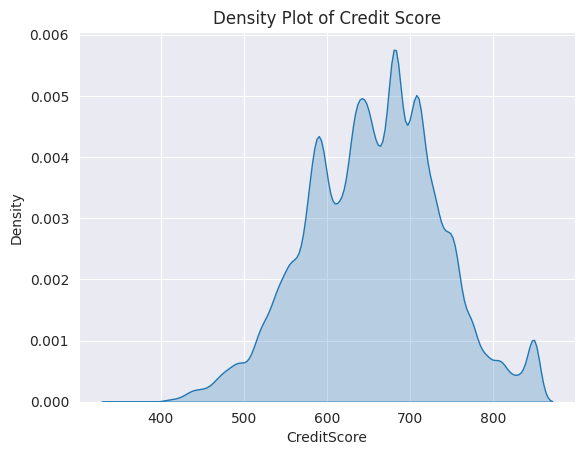

In [32]:
sns.kdeplot(df['CreditScore'], shade=True)
plt.title('Density Plot of Credit Score')
plt.show()


In [33]:

fig = px.box(df, x="Exited", y="Age")
fig.show()

Mean Age who churn back is 45 years approx

/tmp/ipykernel_51478/4204249466.py:1: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




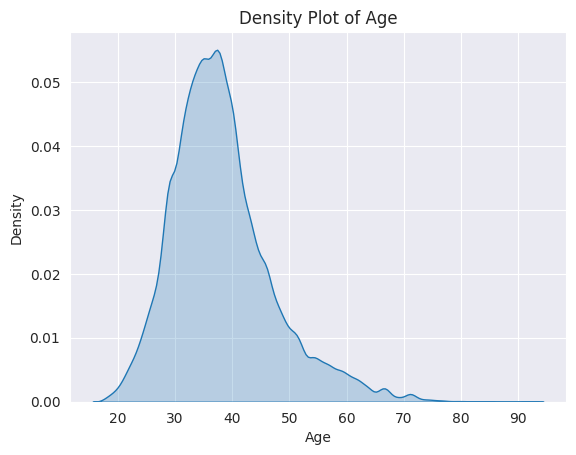

In [34]:
sns.kdeplot(df['Age'], shade=True)
plt.title('Density Plot of Age')
plt.show()


In [35]:

fig = px.box(df, x="Exited", y="Balance")
fig.show()

For, Exited=0, mean balance is 0
and for Exited=1, mean balance is 100k

/tmp/ipykernel_51478/2410487377.py:1: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




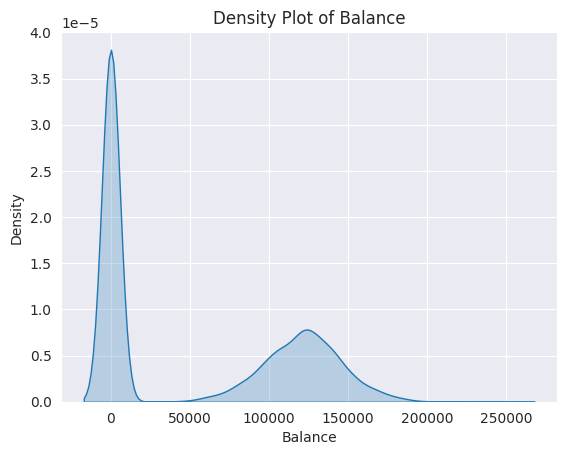

In [36]:
sns.kdeplot(df['Balance'], shade=True)
plt.title('Density Plot of Balance')
plt.show()
#Balance, EstimatedSalary

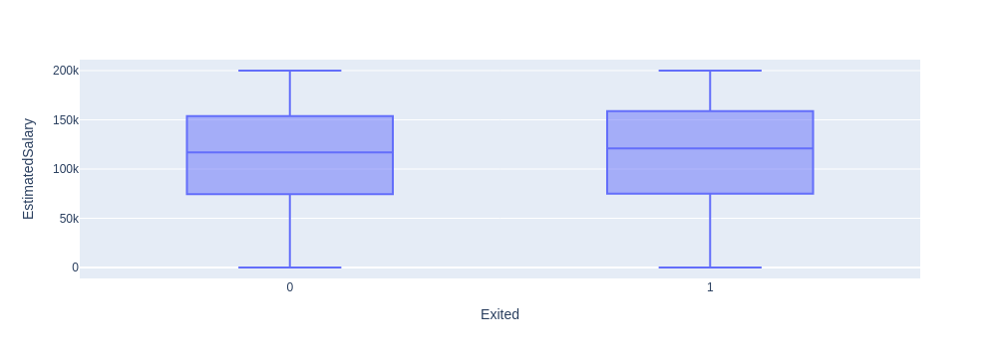

In [45]:

fig = px.box(df, x="Exited", y="EstimatedSalary")
fig.show()

Not much different in mean Estimated salary for Exited variable

/tmp/ipykernel_51478/3016184803.py:1: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




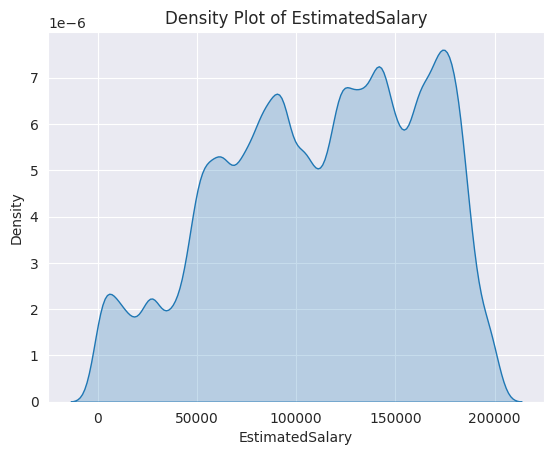

In [37]:
sns.kdeplot(df['EstimatedSalary'], shade=True)
plt.title('Density Plot of EstimatedSalary')
plt.show()
#Balance, EstimatedSalary

Estimate salary and credit score do not much oinfluence our output variable. Lets see if we drop it.

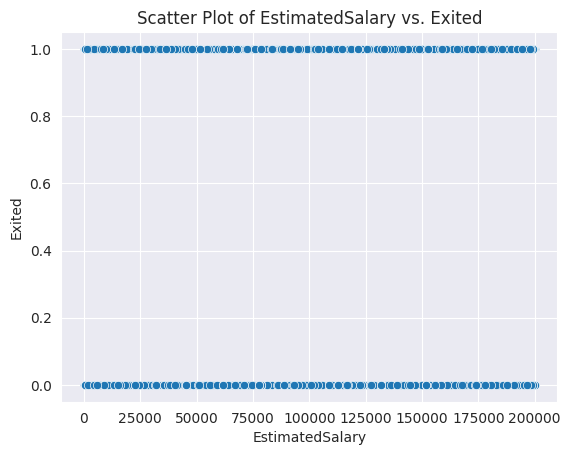

In [38]:
sns.scatterplot(x='EstimatedSalary', y='Exited', data=df)
plt.title('Scatter Plot of EstimatedSalary vs. Exited')
plt.show()

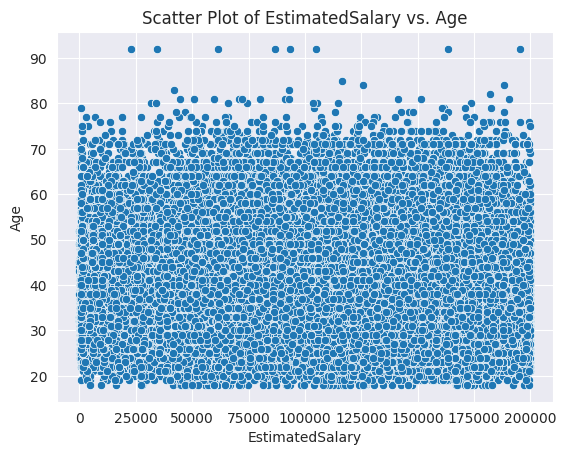

In [39]:
sns.scatterplot(x='EstimatedSalary', y='Age', data=df)
plt.title('Scatter Plot of EstimatedSalary vs. Age')
plt.show()

In [40]:

fig = px.line(df, x="CreditScore", y="EstimatedSalary", color='Exited')
fig.show()

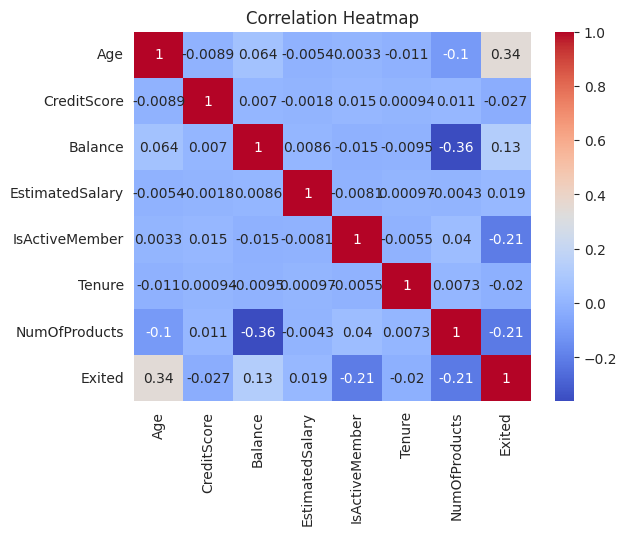

In [41]:
correlation_matrix = df[['Age','CreditScore', 'Balance','EstimatedSalary','IsActiveMember','Tenure','NumOfProducts', 'Exited']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

No features are highly corelated. Only age is corelated with Exited but not with other feature. so we must keep Age.

In [42]:
#Now we need to convert categorical data(Gendr and Geography) to numerical data
#Does feature scaling is required for numerical data here?

In [43]:

X_train,X_test,y_train,y_test = train_test_split(df, df['Exited'] , stratify =df['Exited'] , train_size = 0.7)
print(X_train.shape,y_train.shape,X_test.shape,y_test.shape)

(115523, 10) (115523,) (49511, 10) (49511,)


In [44]:
X_train.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,IsActiveMember,EstimatedSalary,Exited
110392,703,Spain,Female,39,1,0.00,2,1,67832.53,0
68486,684,France,Male,28,4,96845.81,1,1,69578.49,0
105879,674,Spain,Male,31,2,0.00,2,0,98894.64,0
94707,545,France,Female,36,1,123971.99,2,0,121371.33,0
158573,686,Germany,Female,56,5,111642.08,1,1,80553.87,1


In [45]:
encoder=ce.TargetEncoder(cols=['Geography'])
X_train['Geography']=encoder.fit_transform(X_train['Geography'],X_train['Exited'])
X_test['Geography']=encoder.transform(X_test['Geography'])

df_test['Geography']=encoder.transform(df_test['Geography'])

In [46]:
encoder=ce.TargetEncoder(cols=['Gender'])
X_train['Gender']=encoder.fit_transform(X_train['Gender'],X_train['Exited'])
X_test['Gender']=encoder.transform(X_test['Gender'])

df_test['Gender']=encoder.transform(df_test['Gender'])

In [47]:
X_train.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,IsActiveMember,EstimatedSalary,Exited
110392,703,0.173197,0.280204,39,1,0.00,2,1,67832.53,0
68486,684,0.164732,0.158699,28,4,96845.81,1,1,69578.49,0
105879,674,0.173197,0.158699,31,2,0.00,2,0,98894.64,0
94707,545,0.164732,0.280204,36,1,123971.99,2,0,121371.33,0
158573,686,0.378651,0.280204,56,5,111642.08,1,1,80553.87,1


In [48]:
X_train.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,IsActiveMember,EstimatedSalary,Exited
110392,703,0.173197,0.280204,39,1,0.00,2,1,67832.53,0
68486,684,0.164732,0.158699,28,4,96845.81,1,1,69578.49,0
105879,674,0.173197,0.158699,31,2,0.00,2,0,98894.64,0
94707,545,0.164732,0.280204,36,1,123971.99,2,0,121371.33,0
158573,686,0.378651,0.280204,56,5,111642.08,1,1,80553.87,1


In [49]:
X_train=X_train.drop(['Exited'], axis=1)
X_test=X_test.drop(['Exited'], axis=1)

In [50]:
X_train.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,IsActiveMember,EstimatedSalary
110392,703,0.173197,0.280204,39,1,0.00,2,1,67832.53
68486,684,0.164732,0.158699,28,4,96845.81,1,1,69578.49
105879,674,0.173197,0.158699,31,2,0.00,2,0,98894.64
94707,545,0.164732,0.280204,36,1,123971.99,2,0,121371.33
158573,686,0.378651,0.280204,56,5,111642.08,1,1,80553.87


In [51]:
from sklearn.preprocessing import StandardScaler
cols = list(X_train.columns)
scalar = StandardScaler()
X_train[cols] = scalar.fit_transform(X_train[cols])
X_test[cols] = scalar.transform(X_test[cols])
df_test[cols]= scalar.transform(df_test[cols])

In [52]:
def find_optimal_parameter(X_train,y_train):
    max_depth =[1,5,10,50,100]
    n_estimators=[1,5,10,50,100]
    parameters = {'max_depth':[1,5,10,50,100],'n_estimators':[1,5,10,50,100]}
    model = RandomForestClassifier()
    clf = GridSearchCV(model, parameters, cv=5, scoring='roc_auc',return_train_score=True)
    clf.fit(X_train, y_train)

    train_auc_mean= clf.cv_results_['mean_train_score']
    train_auc_std= clf.cv_results_['std_train_score']
    cv_auc_mean = clf.cv_results_['mean_test_score'] 
    cv_auc_std= clf.cv_results_['std_test_score']
    params=clf.cv_results_['params']
    
    y_train_pred =  clf.predict(X_train)
    print("y_train_pred ",y_train_pred)
    
    results = clf.cv_results_
   # print(results)
    print("Best Parameter: ",clf.best_params_)
    print("best_estimator",clf.best_estimator_)
    print(params)
    params_range = list(range(0,len(max_depth)*len(n_estimators)))
    
    plt.plot(params_range, train_auc_mean, label='Train AUC')
    plt.plot(params_range, cv_auc_mean, label='CV AUC')
    plt.legend()
    plt.xlabel("params")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()
    
    return train_auc_mean,cv_auc_mean,clf.best_params_

In [53]:
# Logistic regression for test and its performance
def model_test_performance(X_train,y_train,X_test,y_test,hyper_params):# instantiate learning model k = optimal_k
    
    # train a classifier and prediction for test
    clf = RandomForestClassifier(max_depth=hyper_params['max_depth'],min_samples_split=hyper_params['n_estimators'])
    clf.fit(X_train, y_train)

    train_fpr, train_tpr, thresholds = roc_curve(y_train, clf.predict_proba(X_train)[:,1])
    test_fpr, test_tpr, thresholds = roc_curve(y_test, clf.predict_proba(X_test)[:,1])

    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(metrics.auc(train_fpr, train_tpr)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(metrics.auc(test_fpr, test_tpr)))
    plt.legend()
    plt.xlabel("hyperparameters")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()

    print("="*100)

    print("Train confusion matrix")
    cm_train=confusion_matrix(y_train, clf.predict(X_train))
    print("Train confusion matrix")
    print(cm_train)

    cm=confusion_matrix(y_true=y_test,y_pred=clf.predict(X_test))
    print("Test confusion matrix")
    print(cm)

    labels = ['0','1']

    
    print("-----------Train Confusion Matrics--------")
    df_cm_train = pd.DataFrame(cm_train,  range(2),range(2))    
    sns.heatmap(df_cm_train, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size
    
    
    plt.title("Train Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    
    print("-----------Test Confusion Matrics--------")
    df_cm = pd.DataFrame(cm,  range(2),range(2))    
    sns.heatmap(df_cm, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size

    plt.title("Test Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    return metrics.auc(test_fpr, test_tpr),clf

Let's try XGboost

In [54]:
def find_optimal_parameter_GBDT(X_train,y_train):
    max_depth =[1,5,10,50,100]
    n_estimators=[1,5,10,50,100]
    parameters = {'max_depth':[1,5,10,50,100],'n_estimators':[1,5,10,50,100]}
    model = xgb.XGBClassifier(booster='gbtree')
    clf = GridSearchCV(model, parameters, cv=5, scoring='roc_auc',return_train_score=True)
    clf.fit(X_train, y_train)

    train_auc_mean= clf.cv_results_['mean_train_score']
    train_auc_std= clf.cv_results_['std_train_score']
    cv_auc_mean = clf.cv_results_['mean_test_score'] 
    cv_auc_std= clf.cv_results_['std_test_score']
    params=clf.cv_results_['params']
    
    y_train_pred =  clf.predict(X_train)
    
    results = clf.cv_results_
    print("Best Parameter: ",clf.best_params_)
    print("best_estimator",clf.best_estimator_)
    print(params)
    params_range = list(range(0,len(max_depth)*len(n_estimators)))
    
    plt.plot(params_range, train_auc_mean, label='Train AUC')
    plt.plot(params_range, cv_auc_mean, label='CV AUC')
    plt.legend()
    plt.xlabel("params")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()
    
       
    return train_auc_mean,cv_auc_mean,clf.best_params_

In [55]:
# XGB for test and its performance
def model_test_performance_GBDT(X_train,y_train,X_test,y_test,hyper_params):# instantiate learning model k = optimal_k
    
    # train a classifier and prediction for test
    clf = xgb.XGBClassifier(booster='gbtree',max_depth=hyper_params['max_depth'],min_samples_split=hyper_params['n_estimators'])
    clf.fit(X_train, y_train)

    train_fpr, train_tpr, thresholds = roc_curve(y_train, clf.predict_proba(X_train)[:,1])
    test_fpr, test_tpr, thresholds = roc_curve(y_test, clf.predict_proba(X_test)[:,1])

    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(metrics.auc(train_fpr, train_tpr)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(metrics.auc(test_fpr, test_tpr)))
    plt.legend()
    plt.xlabel("hyperparameters")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()

    print("="*100)

    print("Train confusion matrix")
    cm_train=confusion_matrix(y_train, clf.predict(X_train))
    print("Train confusion matrix")
    print(cm_train)

    cm=confusion_matrix(y_true=y_test,y_pred=clf.predict(X_test))
    print("Test confusion matrix")
    print(cm)

    # Test Confusion Matrix
    labels = ['0','1']

    print("-----------Train Confusion Matrics--------")
    df_cm_train = pd.DataFrame(cm_train,  range(2),range(2))    
    sns.heatmap(df_cm_train, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size
    
    
    plt.title("Train Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    
    print("-----------Test Confusion Matrics--------")
    df_cm = pd.DataFrame(cm,  range(2),range(2))    
    sns.heatmap(df_cm, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size
    
    #skplt.plot_confusion_matrix(y_test ,pred)
    plt.title("Test Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    return metrics.auc(test_fpr, test_tpr),clf


In [56]:
def find_optimal_parameter_CAT(X_train,y_train):
    max_depth =[1,5,10,50,100]
    n_estimators=[5,10,50,100,150]
    parameters = {'max_depth':[1,5,10,50,100],'n_estimators':[5,10,50,100,150]}
    model =  CatBoostClassifier()
    
    clf = GridSearchCV(model, parameters, cv=5, scoring='roc_auc',return_train_score=True)
    clf.fit(X_train, y_train)

    train_auc_mean= clf.cv_results_['mean_train_score']
    train_auc_std= clf.cv_results_['std_train_score']
    cv_auc_mean = clf.cv_results_['mean_test_score'] 
    cv_auc_std= clf.cv_results_['std_test_score']
    params=clf.cv_results_['params']
    
    y_train_pred =  clf.predict(X_train)
    
    results = clf.cv_results_
    print("Best Parameter: ",clf.best_params_)
    print("best_estimator",clf.best_estimator_)
    print(params)
    params_range = list(range(0,len(max_depth)*len(n_estimators)))
    
    plt.plot(params_range, train_auc_mean, label='Train AUC')
    plt.plot(params_range, cv_auc_mean, label='CV AUC')
    plt.legend()
    plt.xlabel("params")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()
    
       
    return train_auc_mean,cv_auc_mean,clf.best_params_

Learning rate set to 0.5
0:	learn: 0.5312460	total: 59.3ms	remaining: 237ms
1:	learn: 0.4693597	total: 68.8ms	remaining: 103ms
2:	learn: 0.4388629	total: 81.3ms	remaining: 54.2ms
3:	learn: 0.4204302	total: 89.8ms	remaining: 22.4ms
4:	learn: 0.4047771	total: 104ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.5333441	total: 16.3ms	remaining: 65.1ms
1:	learn: 0.4718535	total: 47ms	remaining: 70.4ms
2:	learn: 0.4412313	total: 63.8ms	remaining: 42.5ms
3:	learn: 0.4195198	total: 82ms	remaining: 20.5ms
4:	learn: 0.4037201	total: 94.4ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.5327759	total: 5.8ms	remaining: 23.2ms
1:	learn: 0.4715096	total: 10.9ms	remaining: 16.3ms
2:	learn: 0.4412074	total: 19ms	remaining: 12.7ms
3:	learn: 0.4195308	total: 24ms	remaining: 5.99ms
4:	learn: 0.4038690	total: 35ms	remaining: 0us
Learning rate set to 0.5
0:	learn: 0.5312212	total: 4.76ms	remaining: 19ms
1:	learn: 0.4693924	total: 9.87ms	remaining: 14.8ms
2:	learn: 0.4390395	total: 17.7ms	remaini

/home/bunny/Documents/AssistiveDomotical/.venv/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:516: FitFailedWarning:


50 fits failed out of a total of 125.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
50 fits failed with the following error:
Traceback (most recent call last):
  File "/home/bunny/Documents/AssistiveDomotical/.venv/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/bunny/Documents/AssistiveDomotical/.venv/lib/python3.12/site-packages/catboost/core.py", line 5245, in fit
    self._fit(X, y, cat_features, text_features, embedding_features, None, graph, sample_weight, None, None, None, None, 

Learning rate set to 0.5
0:	learn: 0.4822753	total: 59.6ms	remaining: 2.92s
1:	learn: 0.4033980	total: 122ms	remaining: 2.92s
2:	learn: 0.3670410	total: 161ms	remaining: 2.53s
3:	learn: 0.3461857	total: 219ms	remaining: 2.52s
4:	learn: 0.3384277	total: 262ms	remaining: 2.36s
5:	learn: 0.3315720	total: 317ms	remaining: 2.33s
6:	learn: 0.3284307	total: 370ms	remaining: 2.27s
7:	learn: 0.3269379	total: 398ms	remaining: 2.09s
8:	learn: 0.3258808	total: 441ms	remaining: 2.01s
9:	learn: 0.3245105	total: 481ms	remaining: 1.92s
10:	learn: 0.3239616	total: 531ms	remaining: 1.88s
11:	learn: 0.3236242	total: 568ms	remaining: 1.8s
12:	learn: 0.3233057	total: 597ms	remaining: 1.7s
13:	learn: 0.3224405	total: 625ms	remaining: 1.61s
14:	learn: 0.3222642	total: 660ms	remaining: 1.54s
15:	learn: 0.3220723	total: 694ms	remaining: 1.48s
16:	learn: 0.3216745	total: 719ms	remaining: 1.4s
17:	learn: 0.3213524	total: 753ms	remaining: 1.34s
18:	learn: 0.3212427	total: 770ms	remaining: 1.26s
19:	learn: 0.32106

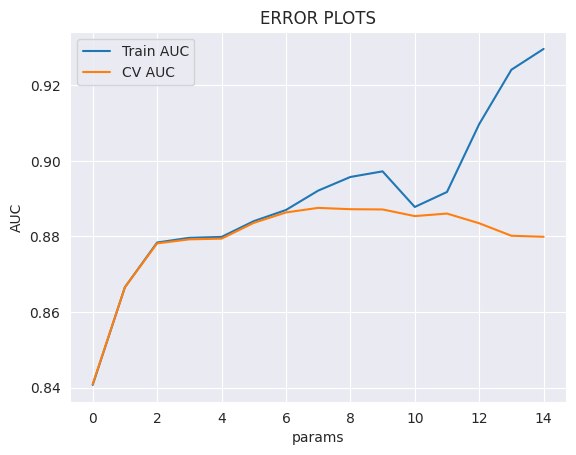

In [57]:
train_auc_mean_CAT,cv_auc_mean_CAT,params_CAT=find_optimal_parameter_CAT(X_train,y_train)

In [58]:
# XGB for test and its performance
def model_test_performance_CAT(X_train,y_train,X_test,y_test,hyper_params):# instantiate learning model k = optimal_k
    
    # train a classifier and prediction for test
    clf = CatBoostClassifier(max_depth=hyper_params['max_depth'],n_estimators=hyper_params['n_estimators']);
    clf.fit(X_train, y_train)

    train_fpr, train_tpr, thresholds = roc_curve(y_train, clf.predict_proba(X_train)[:,1])
    test_fpr, test_tpr, thresholds = roc_curve(y_test, clf.predict_proba(X_test)[:,1])

    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(metrics.auc(train_fpr, train_tpr)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(metrics.auc(test_fpr, test_tpr)))
    plt.legend()
    plt.xlabel("hyperparameters")
    plt.ylabel("AUC")
    plt.title("ERROR PLOTS")
    plt.show()

    print("="*100)

    print("Train confusion matrix")
    cm_train=confusion_matrix(y_train, clf.predict(X_train))
    print("Train confusion matrix")
    print(cm_train)

    cm=confusion_matrix(y_true=y_test,y_pred=clf.predict(X_test))
    print("Test confusion matrix")
    print(cm)

    # Test Confusion Matrix
    labels = ['0','1']

    print("-----------Train Confusion Matrics--------")
    df_cm_train = pd.DataFrame(cm_train,  range(2),range(2))    
    sns.heatmap(df_cm_train, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size
    
    
    plt.title("Train Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    
    print("-----------Test Confusion Matrics--------")
    df_cm = pd.DataFrame(cm,  range(2),range(2))    
    sns.heatmap(df_cm, annot=True, cmap='Oranges', annot_kws={"size": 20},fmt='g')# font size

    plt.title("Test Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    
    return (metrics.auc(test_fpr, test_tpr),clf)


{'max_depth': 5, 'n_estimators': 50}
Learning rate set to 0.5
0:	learn: 0.4822753	total: 20.6ms	remaining: 1.01s
1:	learn: 0.4033980	total: 40.6ms	remaining: 975ms
2:	learn: 0.3670410	total: 60.1ms	remaining: 942ms
3:	learn: 0.3461857	total: 78.6ms	remaining: 904ms
4:	learn: 0.3384277	total: 100ms	remaining: 901ms
5:	learn: 0.3315720	total: 129ms	remaining: 946ms
6:	learn: 0.3284307	total: 157ms	remaining: 965ms
7:	learn: 0.3269379	total: 188ms	remaining: 986ms
8:	learn: 0.3258808	total: 211ms	remaining: 962ms
9:	learn: 0.3245105	total: 239ms	remaining: 955ms
10:	learn: 0.3239616	total: 264ms	remaining: 936ms
11:	learn: 0.3236242	total: 276ms	remaining: 873ms
12:	learn: 0.3233057	total: 291ms	remaining: 827ms
13:	learn: 0.3224405	total: 316ms	remaining: 813ms
14:	learn: 0.3222642	total: 330ms	remaining: 771ms
15:	learn: 0.3220723	total: 343ms	remaining: 730ms
16:	learn: 0.3216745	total: 363ms	remaining: 704ms
17:	learn: 0.3213524	total: 383ms	remaining: 681ms
18:	learn: 0.3212427	total

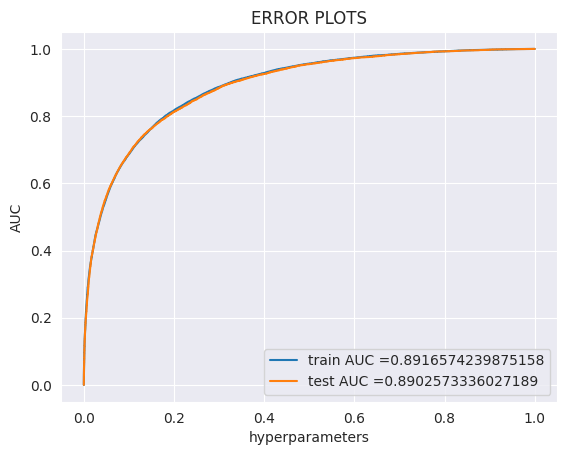

Train confusion matrix
Train confusion matrix
[[86626  4452]
 [10941 13504]]
Test confusion matrix
[[37147  1888]
 [ 4663  5813]]
-----------Train Confusion Matrics--------


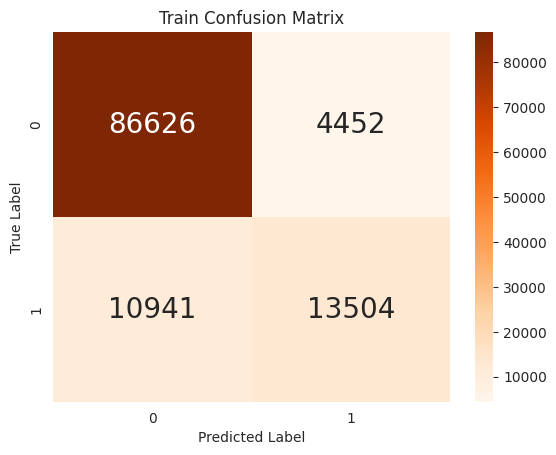

-----------Test Confusion Matrics--------


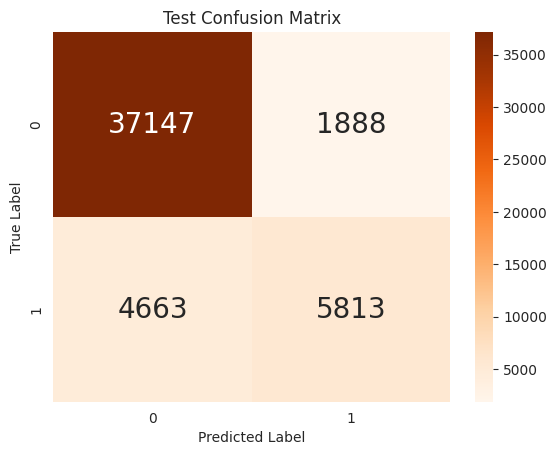

In [59]:
# train a classifier and prediction for test for BOW
print(params_CAT)
auc_CAT,clf_CAT=model_test_performance_CAT(X_train,y_train,X_test,y_test,params_CAT)


In [62]:
print(auc_CAT)
y_pred_CAT=clf_CAT.predict_proba(df_test)[:, 1]

0.8902573336027189


In [61]:
def plot_feature_importance(importance,names,model_type):

    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    #Add chart labels
    plt.title(model_type + ' FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

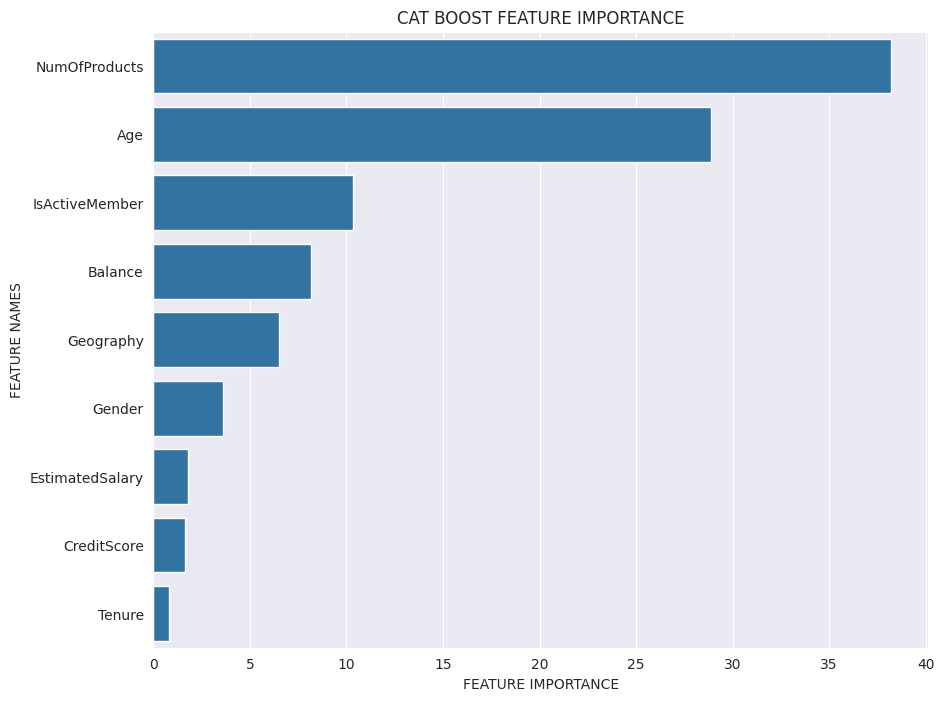

In [63]:
plot_feature_importance(clf_CAT.feature_importances_,X_train.columns,'CAT BOOST')

<h2> Save Submission File

In [64]:
# save submission

sample_sub['Exited']=y_pred_CAT
results = sample_sub[['id', 'Exited']]
results.to_csv('kaggle/working/submission.csv', index=False)

In [65]:
results.head()

,id,Exited
0,165034,0.017360
1,165035,0.805602
2,165036,0.027087
3,165037,0.237944
4,165038,0.332586
